In [3]:
!cp /Users/sagar/Downloads/Data\ Sets-20181213T163450Z-001.zip data

In [4]:
!tar xvf data

x Data Sets/DIQ_Part1/set13/2012-04-23_12-21-01_51.jpg
x Data Sets/DIQ_Part1/set13/2012-04-23_12-20-41_274.jpg
x Data Sets/DIQ_Part1/set13/2012-04-23_12-20-32_300.jpg
x Data Sets/DIQ_Part1/set13/2012-04-23_12-20-25_136.jpg
x Data Sets/DIQ_Part1/set13/2012-04-23_12-19-33_502.jpg
x Data Sets/DIQ_Part1/set13/2012-04-23_12-19-21_495.jpg
x Data Sets/DIQ_Part1/set13/2012-04-23_12-19-10_631.jpg
x Data Sets/DIQ_Part1/set13/eval_2012-04-23_12-21-01_51.txt
x Data Sets/DIQ_Part1/set13/eval_2012-04-23_12-20-41_274.txt
x Data Sets/DIQ_Part1/set13/eval_2012-04-23_12-19-33_502.txt
x Data Sets/DIQ_Part1/set13/2012-04-23_12-20-32_300.txt
x Data Sets/DIQ_Part1/set13/2012-04-23_12-21-01_51.txt
x Data Sets/DIQ_Part1/set13/2012-04-23_12-20-25_136.txt
x Data Sets/DIQ_Part1/set13/eval_2012-04-23_12-19-10_631.txt
x Data Sets/DIQ_Part1/set13/eval_2012-04-23_12-20-25_136.txt
x Data Sets/DIQ_Part1/set13/eval_2012-04-23_12-20-32_300.txt
x Data Sets/DIQ_Part1/set13/2012-04-23_12-20-41_274.txt
x Data Sets/DIQ_Part1

In [5]:
!mkdir imgs

In [6]:
!cp Data\ Sets/*/*/*.jpg imgs/

In [7]:
!ls imgs | wc -l

     175


In [8]:
!mkdir conv_imgs

In [ ]:
# to make it clean, extracted all images from each set to a dir (imgs_dir) and another dir to hold the converted imgs(conv_imgs)

100%|██████████| 175/175 [00:43<00:00,  4.00it/s]


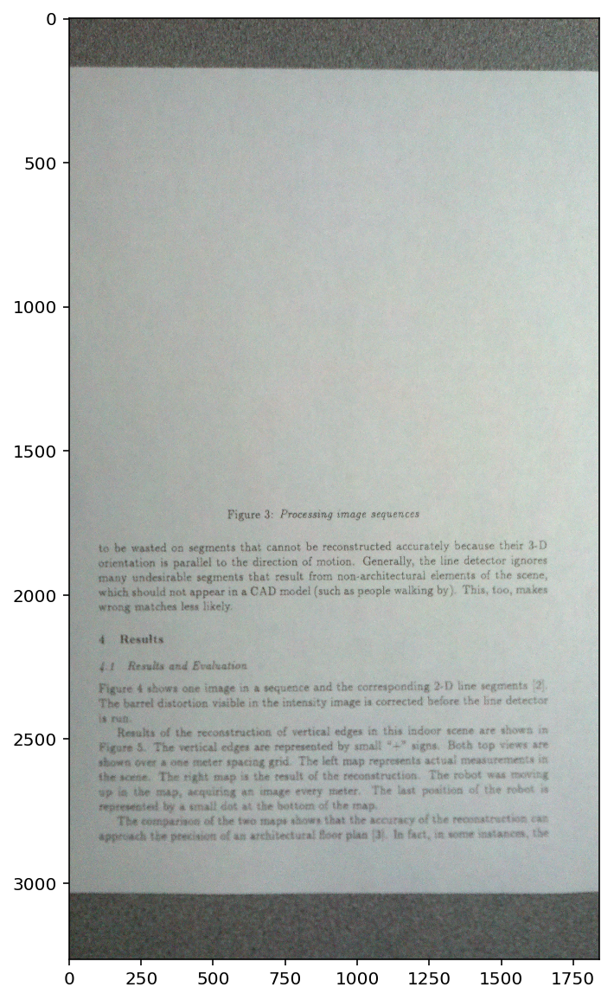

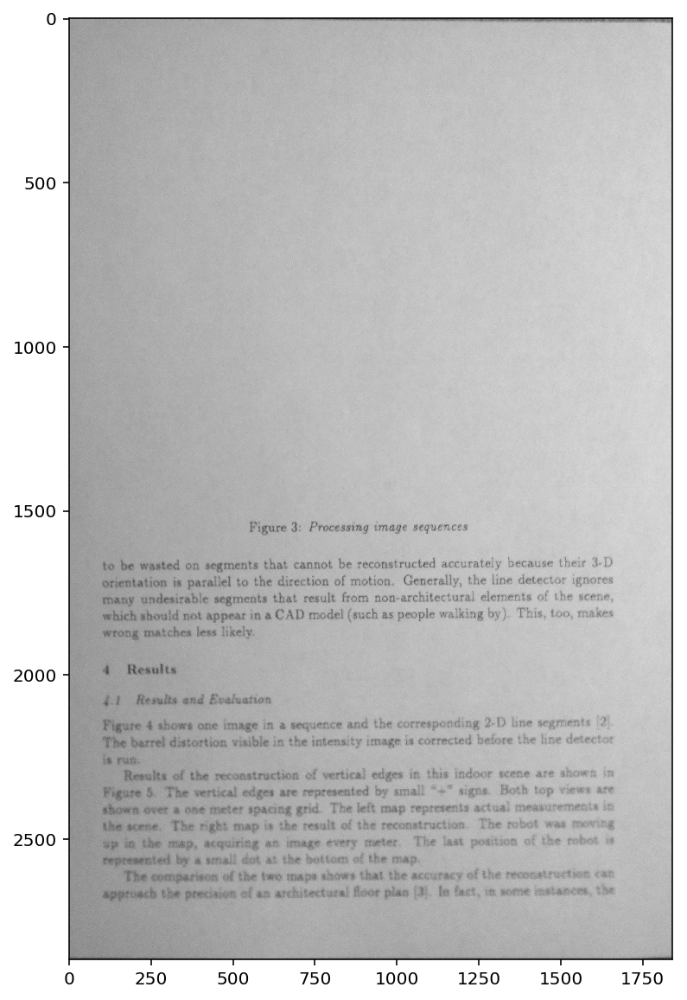

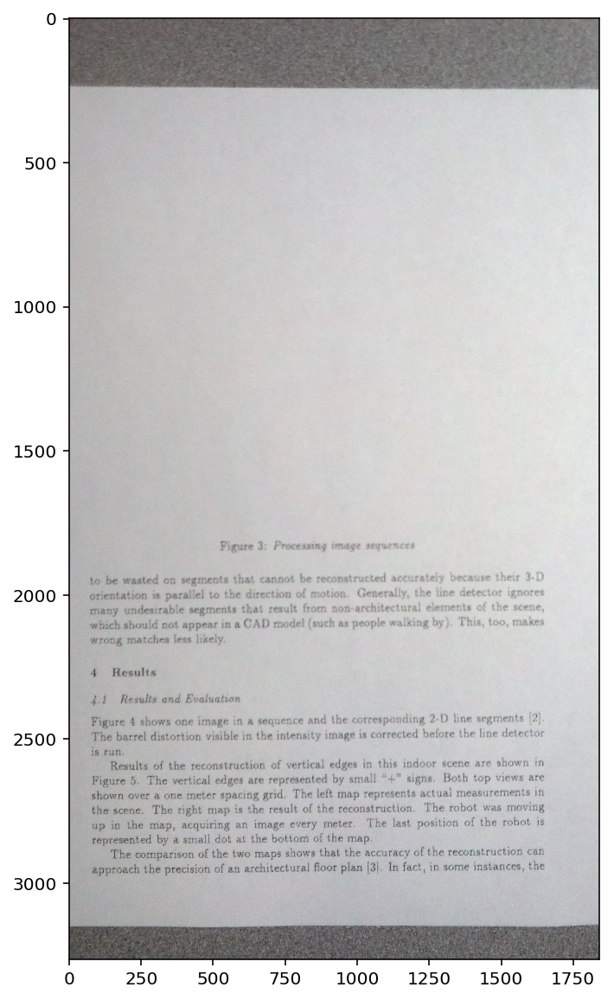

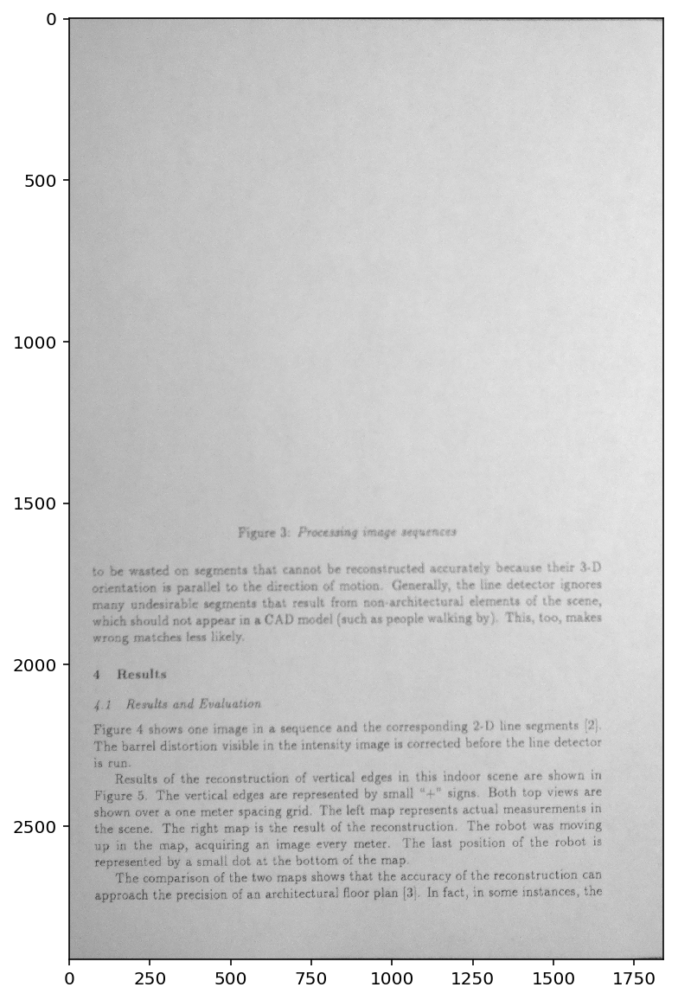

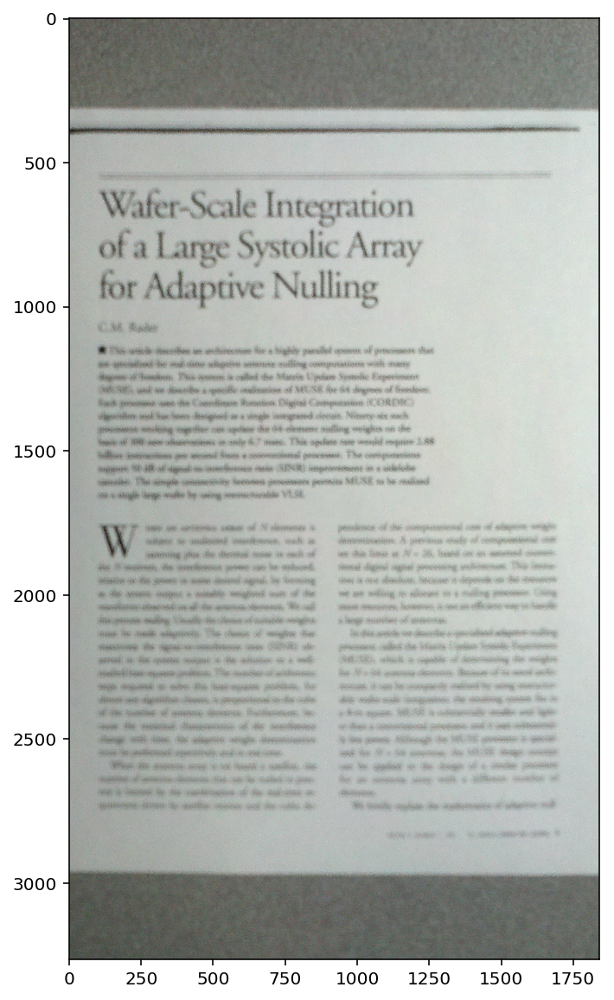

...

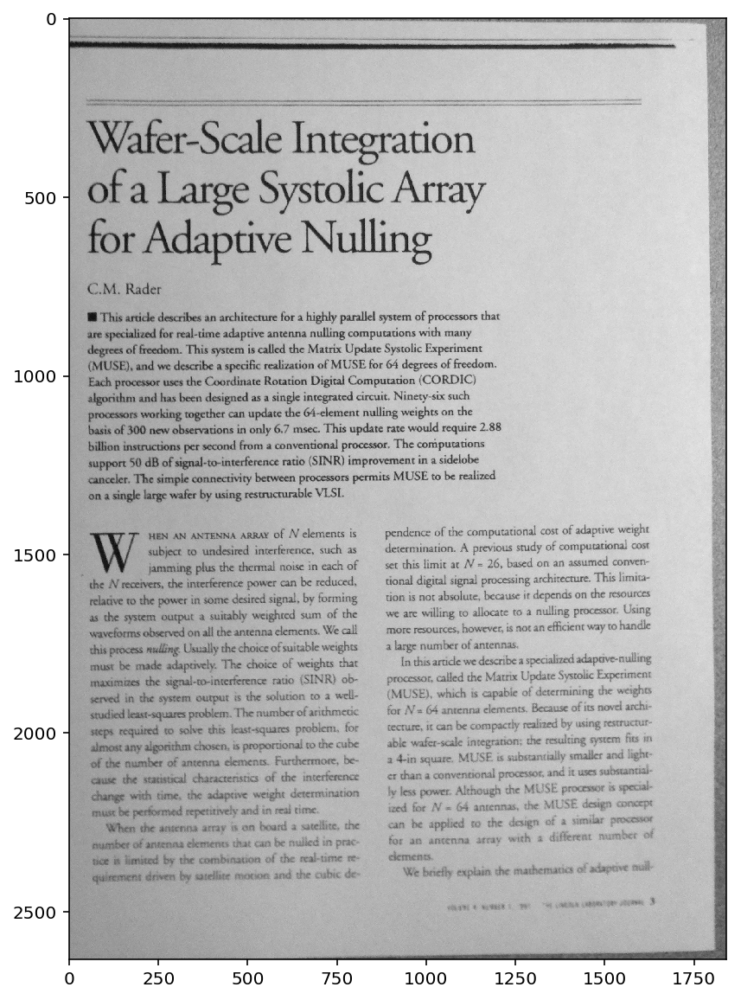

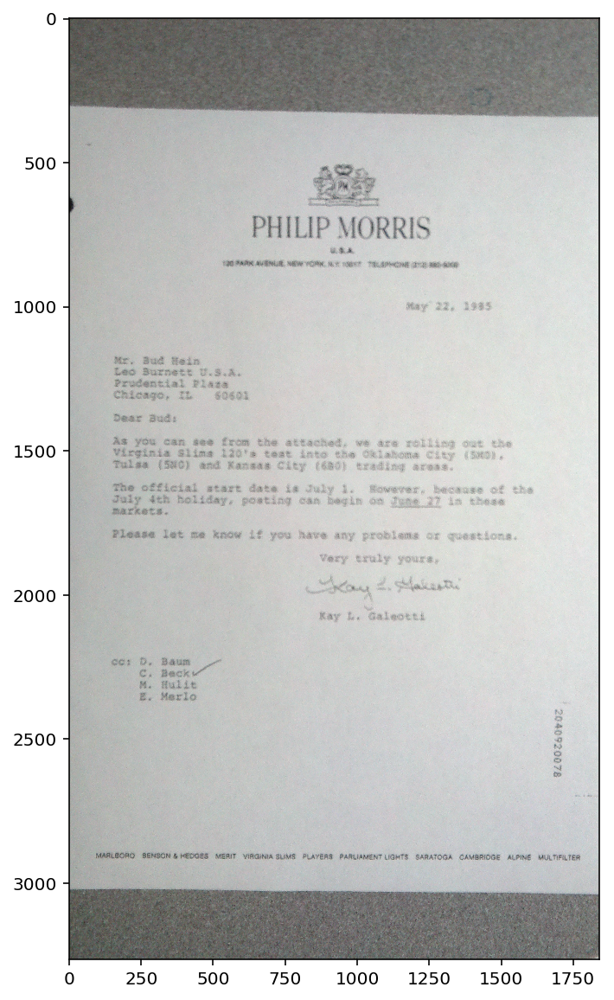

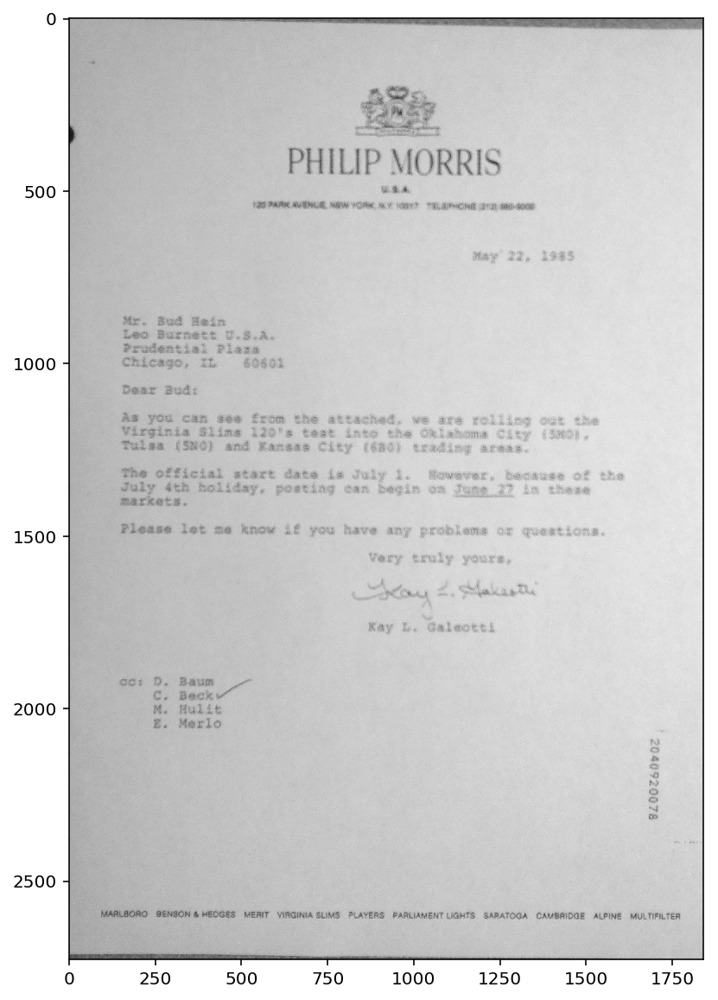

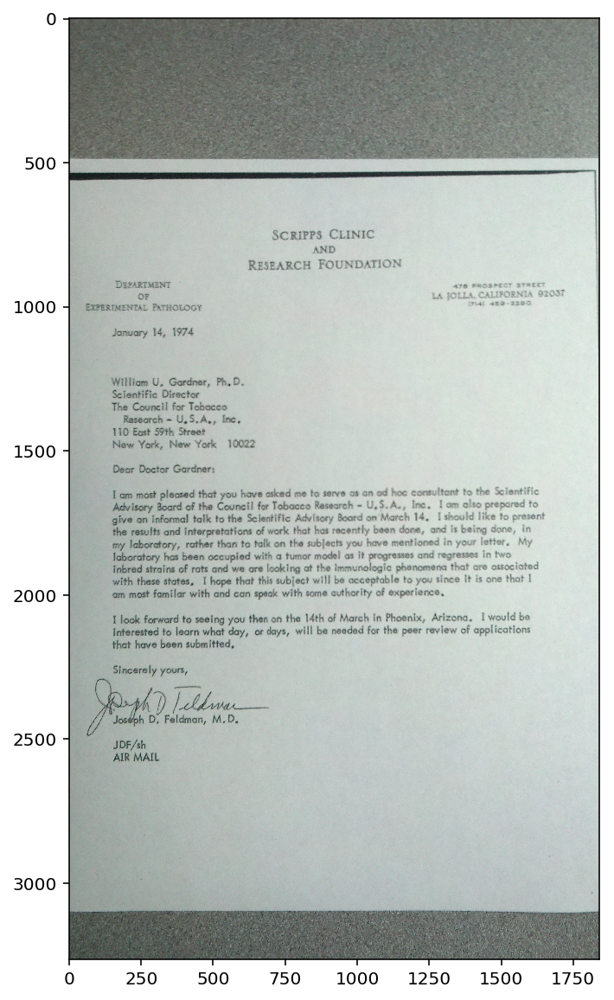

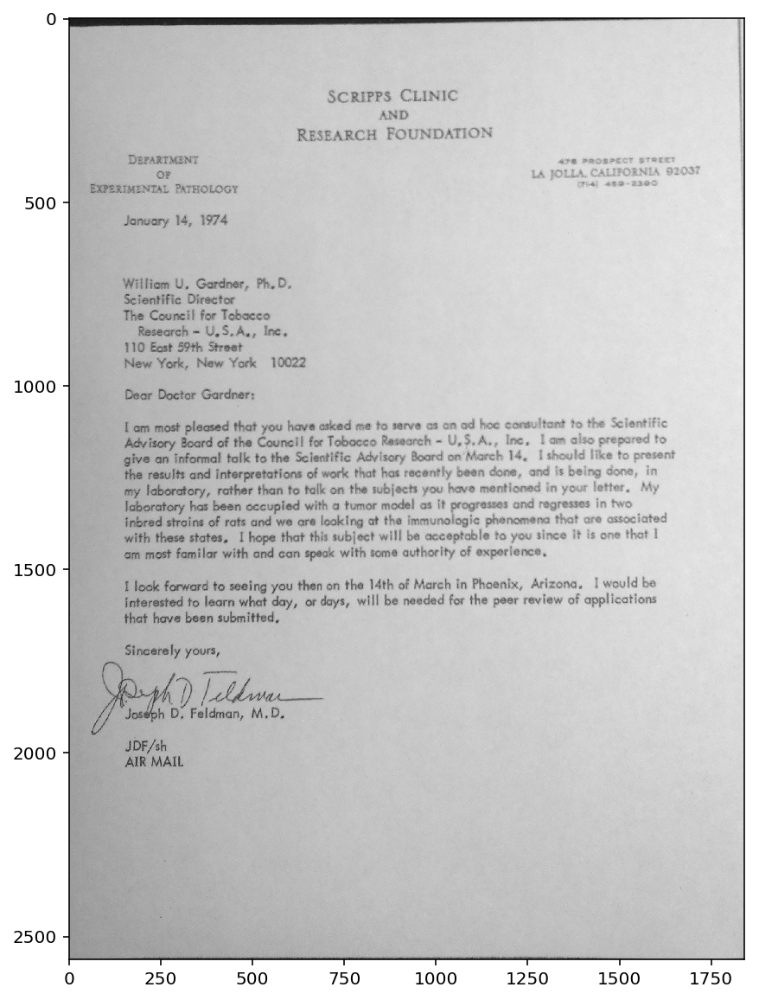

In [235]:
# %%writefile detect_and_segment.py
#imports
import glob
import cv2
import numpy as np
from operator import itemgetter
import matplotlib.pyplot as plt
import tqdm
# visualize better inline
%config InlineBackend.figure_format = 'retina'

def img_thresh(path):
    image = cv2.imread(path, 0) # read grayscale directly
    image_gray = cv2.blur(image,(450,10)) # intentional skewed, as all images are horizontal
    im_th = cv2.adaptiveThreshold(image_gray, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 4501, 0) # adaptie for robustness
    return im_th

def find_contour_rect(image):
    _,ctrs, _ = cv2.findContours(image.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    rects = [cv2.boundingRect(ctr) for ctr in ctrs] # get the rectangle corresponding to each contour
    return rects

def show(img):
    # utility function to visualize images
    plt.figure(figsize=(10,10))
    plt.imshow(img);
    plt.show();

def crop_and_save(img,boinding_points,f_name):
    # crop the image and save to new file
    [(x1,y1),(x2,y2)] = boinding_points
    cv2.imwrite(f_name,img[y1:y2,x1:x2])

def detect_and_segment(fname, save_dir='conv_imgs/'):
    im_th = img_thresh(fname)
    rects = find_contour_rect(im_th)
    (x,y,w,h) = max(rects,key=itemgetter(3))   #finding the largest box with height
    crop_and_save(im, [(x, y), (x + w, y + h)], 'conv_imgs/'+f.split('/')[-1])

def visualize_both(fname, img_dir='imgs/', out_img_dir='conv_imgs/'):
    i = cv2.imread(img_dir+fname)
    o = cv2.imread(out_img_dir+fname)
    show(i)
    show(o)

if __name__=="__main__":
    file_list = glob.glob('imgs/*.jpg') # load all image file
    _ = map(detect_and_segment,tqdm.tqdm(file_list)) # pythonic call to function and decoration with tqdm
    vis_file_list = [x.split('/')[-1] for x in np.random.choice(file_list, size=10)]
    _ = map(visualize_both,vis_file_list) # lets visualize randomly 10 images